# **Credit Card Fraud Detection**

## **Libraries**
*In the code below we will start off by importing all of the necessary libraries for our analysis Some of these libraries have data preprocessing, model building and evaluation tools. These imports provide more efficient ways to handle data, implement a clean machine learning algorithm and even better display our results. Furthermore, it has specially prepared packages for handling imbalanced datasets and tuning machine learning model.*

In [ ]:
#Importing necessary libraries
import pandas as pd
import numpy as np
import io
import pandas as pd
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
import folium
from folium.plugins import HeatMap
import seaborn as sns
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler, LabelEncoder, MinMaxScaler
from sklearn.pipeline import Pipeline
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split, RepeatedStratifiedKFold, GridSearchCV
from sklearn.metrics import RocCurveDisplay, confusion_matrix, classification_report, accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from sklearn.linear_model import Ridge
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split
import xgboost as xgb
import lightgbm as lgb
import tensorflow as tf
from tensorflow.keras.layers import LSTM, Dense, Dropout, Bidirectional
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
# Enable eager execution
tf.config.run_functions_eagerly(True)
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from prettytable import PrettyTable
import warnings
warnings.filterwarnings('ignore')

# For data visualization
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from wordcloud import WordCloud


*To begin our analysis,we'llwe load the dataset using the **pandas** library, which enables us to read the CSV file into a DataFrame for further analysis.*

*To gain an initial understanding of the data, we use the **info()** method. This method provides us with important details about the dataset, including the number of non-null entries in each column and their respective data types. This step helps identify any missing values and understand the structure of the data before proceeding with further analysis.*

In [ ]:
df = pd.read_csv('fraud_data.csv')


# By the info method we can check the Nan values and the datatype of all the columns in our dataframe
df.info(verbose= True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14446 entries, 0 to 14445
Data columns (total 15 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   trans_date_trans_time  14446 non-null  object 
 1   merchant               14446 non-null  object 
 2   category               14446 non-null  object 
 3   amt                    14446 non-null  float64
 4   city                   14446 non-null  object 
 5   state                  14446 non-null  object 
 6   lat                    14446 non-null  float64
 7   long                   14446 non-null  float64
 8   city_pop               14446 non-null  int64  
 9   job                    14446 non-null  object 
 10  dob                    14446 non-null  object 
 11  trans_num              14446 non-null  object 
 12  merch_lat              14446 non-null  float64
 13  merch_long             14446 non-null  float64
 14  is_fraud               14446 non-null  object 
dtypes:

### **The data-set comprises 14,446 entries and there are total of 15 columns in it for the following key features :-**

**trans_date_trans_time:** Transaction date and time.

**merchant-** The merchant's name where the transaction has taken place.

**category:** Transaction category

**amt:** This is where the amount of transaction goes in.

**city:** City where the transaction happened

**state:** If you entered the state in which this transaction occurred.

**Latitude:** the transaction location.

**Location_long** the longitude of transaction location.

**city_pop:** the city's population.

**job:** job title of person who transacts

**dob:** The date of birth for the purpose why the person is involved in transaction.

**trans_num:** Transaction number, unique for each.

**merch_lat:** Latitude of the merchant location

**merch_long:** Longitude of the merchant location

**is_fraud:** Fraud flag (1 if fraudulent, otherwise 0).

## **Data Inspection:**

*we will perform an initial inspection of the dataset to understand its structure and contents. This step involves examining the dataset's features, identifying any missing values, and understanding the data types associated with each feature. Such an inspection is crucial as it guides the preprocessing steps and helps identify any issues that need to be addressed before moving forward with model development.*



In [ ]:
# Checking the shape of the dataframe
df.shape

(14446, 15)

In [ ]:
# Displaying the first few rows of the dataframe
df.head()

,trans_date_trans_time,merchant,category,amt,city,state,lat,long,city_pop,job,dob,trans_num,merch_lat,merch_long,is_fraud
0,04-01-2019 00:58,"""Stokes, Christiansen and Sipes""",grocery_net,14.37,Wales,AK,64.7556,-165.6723,145,"""Administrator, education""",09-11-1939,a3806e984cec6ac0096d8184c64ad3a1,65.654142,-164.722603,1
1,04-01-2019 15:06,Predovic Inc,shopping_net,966.11,Wales,AK,64.7556,-165.6723,145,"""Administrator, education""",09-11-1939,a59185fe1b9ccf21323f581d7477573f,65.468863,-165.473127,1
2,04-01-2019 22:37,Wisozk and Sons,misc_pos,49.61,Wales,AK,64.7556,-165.6723,145,"""Administrator, education""",09-11-1939,86ba3a888b42cd3925881fa34177b4e0,65.347667,-165.914542,1
3,04-01-2019 23:06,Murray-Smitham,grocery_pos,295.26,Wales,AK,64.7556,-165.6723,145,"""Administrator, education""",09-11-1939,3a068fe1d856f0ecedbed33e4b5f4496,64.445035,-166.080207,1
4,04-01-2019 23:59,Friesen Lt,health_fitness,18.17,Wales,AK,64.7556,-165.6723,145,"""Administrator, education""",09-11-1939,891cdd1191028759dc20dc224347a0ff,65.447094,-165.446843,1


In [ ]:
# Displaying the first few rows of the dataframe
df.tail()

,trans_date_trans_time,merchant,category,amt,city,state,lat,long,city_pop,job,dob,trans_num,merch_lat,merch_long,is_fraud
14441,22-01-2019 00:37,Hudson-Grady,shopping_pos,122.00,Athena,OR,45.8289,-118.4971,1302,Dealer,18-10-1976,699a4c06b22711bf3e0d8ef91232d356,46.442439,-118.524214,0
14442,22-01-2019 00:41,"""Nienow, Ankunding and Collie""",misc_pos,9.07,Gardiner,OR,43.7857,-124.1437,260,"""Engineer, maintenance""",01-09-1956,080d620d24815c7d6c637cf0b71dde8e,42.901265,-124.995317,0
14443,22-01-2019 00:42,Pacocha-O'Reilly,grocery_pos,104.84,Alva,WY,44.6873,-104.4414,110,"""Administrator, local government""",16-05-1973,3c346c8cd627c5fe3ed57430db2e9ae7,45.538062,-104.542117,0
14444,22-01-2019 00:48,"""Bins, Balistreri and Beatty""",shopping_pos,268.16,Wales,AK,64.7556,-165.6723,145,"""Administrator, education""",09-11-1939,e66ffcc95ba7fc490486242af1205d04,64.081462,-165.898698,0
14445,22-01-2019 00:55,Daugherty-Thompson,food_dining,50.09,Unionville,MO,40.4815,-92.9951,3805,"""Investment banker, corporate""",15-09-1950,65e7370f473f9b9d75796c8033a7c929,40.387243,-92.224871,0


In [ ]:
# Using the column attribute to see what type of information is stored in the data.
df.columns

Index(['trans_date_trans_time', 'merchant', 'category', 'amt', 'city', 'state',
       'lat', 'long', 'city_pop', 'job', 'dob', 'trans_num', 'merch_lat',
       'merch_long', 'is_fraud'],
      dtype='object')

In [ ]:
# The describe() function applies basic statistical computations on the dataset like extreme values,count of data points etc.
df.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
trans_date_trans_time,14446,12126,26-12-2020 23:29,5,NaN,NaN,NaN,NaN,NaN,NaN,NaN
merchant,14446,693,Kilback LLC,58,NaN,NaN,NaN,NaN,NaN,NaN,NaN
category,14446,14,grocery_pos,1602,NaN,NaN,NaN,NaN,NaN,NaN,NaN
amt,14446.0,NaN,NaN,NaN,124.430073,231.352587,1.0,12.08,51.52,101.03,3261.47
city,14446,176,Phoenix,297,NaN,NaN,NaN,NaN,NaN,NaN,NaN
state,14446,13,CA,3375,NaN,NaN,NaN,NaN,NaN,NaN,NaN
lat,14446.0,NaN,NaN,NaN,39.787692,5.317039,20.0271,36.7154,39.6662,41.9404,66.6933
long,14446.0,NaN,NaN,NaN,-110.874225,12.985813,-165.6723,-120.4158,-111.0985,-101.136,-89.6287
city_pop,14446.0,NaN,NaN,NaN,106537.002838,290291.609056,46.0,493.0,1645.0,35439.0,2383912.0
job,14446,163,"""Surveyor, minerals""",262,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# Check for missing values in the dataset
missing_values = df.isnull().sum()
print(missing_values)

trans_date_trans_time    0
merchant                 0
category                 0
amt                      0
city                     0
state                    0
lat                      0
long                     0
city_pop                 0
job                      0
dob                      0
trans_num                0
merch_lat                0
merch_long               0
is_fraud                 0
dtype: int64


In [ ]:
# Check unique values for categorical columns
categorical_unique_values = {
    'merchant': df['merchant'].nunique(),
    'category': df['category'].nunique(),
    'city': df['city'].nunique(),
    'state': df['state'].nunique(),
    'job': df['job'].nunique(),
    'is_fraud': df['is_fraud'].unique()
}

categorical_unique_values

{'merchant': 693,
 'category': 14,
 'city': 176,
 'state': 13,
 'job': 163,
 'is_fraud': array(['1', '1"2020-12-24 16:56:24"', '0', '0"2019-01-01 00:00:44"'],
       dtype=object)}

## **Data Cleaning**
*We focus on preparing the dataset for analysis by addressing potential issues that could affect the accuracy of our models. We start by cleaning the is_fraud column, ensuring it contains only binary values (0 or 1). This step is crucial because it standardizes the target variable for our classification task.*

*Next, we check for duplicate rows in the dataset, which could skew our analysis and model performance if not handled properly. By counting and removing any duplicates, we ensure that each data point in our dataset is unique. After removing duplicates, we verify the shape of the dataset to confirm that the cleaning process was successful.*

In [ ]:
# Clean the `is_fraud` column by extracting only the first character (0 or 1)
df['is_fraud'] = df['is_fraud'].str[0]

# Verify that the column now contains only 0 and 1
cleaned_is_fraud_values = df['is_fraud'].unique()
cleaned_is_fraud_values

array(['1', '0'], dtype=object)

In [ ]:
# Check for duplicate rows in the dataset
duplicate_rows = df.duplicated()

In [ ]:
# Count the number of duplicate rows
num_duplicates = duplicate_rows.sum()

In [ ]:
# If there are duplicates, remove them
df_cleaned = df.drop_duplicates()

In [ ]:
# Verify the shape of the data after removing duplicates
new_shape = df_cleaned.shape

In [ ]:
num_duplicates, new_shape

(63, (14383, 15))

In [ ]:
#reassigning the variable df
df = df_cleaned

# **Visualization:**

*In this section, we will explore the data through various visualizations. Visualizing the data helps us identify patterns, trends, and potential outliers that may not be immediately apparent from raw data. By using plots and charts, we can better understand the distribution of features, relationships between variables, and the overall structure of the dataset.*

## **Outlier Detection and Treatment:**
*We utilize boxplots to detect outliers within our numerical features. Boxplots provide a visual summary of the minimum, first quartile, median, third quartile, and maximum values in the data, along with any potential outliers represented as individual points beyond the whiskers of the plot.*

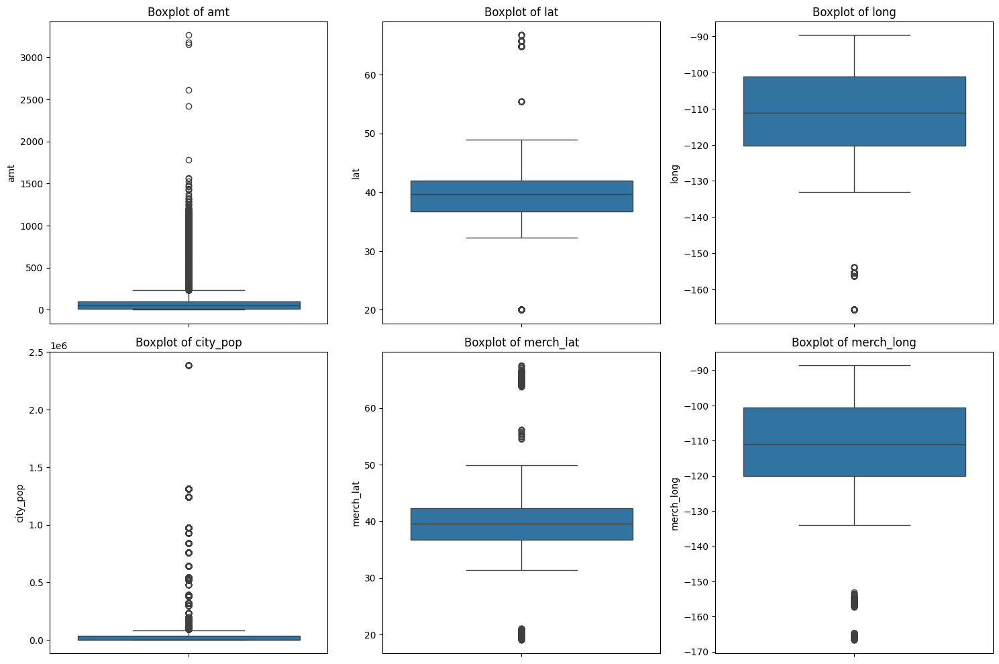

In [ ]:
# Select numerical columns for visualization
numerical_columns = ['amt', 'lat', 'long', 'city_pop', 'merch_lat', 'merch_long']

# Create boxplots for each numerical column
plt.figure(figsize=(15, 10))
for i, column in enumerate(numerical_columns, 1):
    plt.subplot(2, 3, i)
    sns.boxplot(df[column])
    plt.title(f'Boxplot of {column}')
plt.tight_layout()
plt.show()


### **Observations:**

**amt (Transaction Amount):**

* There are several outliers in the amt feature, with transaction amounts significantly higher than the general distribution of the data.
* These outliers may represent unusually high transactions, which could be indicative of fraud or errors in the data entry.

**lat (Latitude) and long (Longitude):**

* Both lat and long show a few outliers. These could result from incorrect data entries or transactions occurring in geographically extreme locations.
* It's essential to verify whether these outliers are valid or if they should be removed or corrected.

**city_pop (City Population):**

* The city_pop feature has numerous outliers, particularly at the higher end of the population scale.
* These outliers may represent transactions occurring in large metropolitan areas, which could be normal depending on the dataset's context.

**merch_lat and merch_long (Merchant Latitude and Longitude):**

* Similar to lat and long, these features also exhibit outliers that may correspond to merchants in remote or extreme geographic locations.
* These need to be examined to determine if they are genuine or if they require data correction.

In [ ]:
# Function to detect and treat outliers using the IQR method
def detect_and_treat_outliers(df, columns):
    outlier_indices = {}

    for column in columns:
        Q1 = df[column].quantile(0.25)
        Q3 = df[column].quantile(0.75)
        IQR = Q3 - Q1

        # Define outlier boundaries
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        # Identify outliers
        outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)].index
        outlier_indices[column] = outliers

    return outlier_indices

# Detect outliers in the numerical columns
outlier_indices = detect_and_treat_outliers(df, numerical_columns)

# Display the number of outliers detected in each column
outliers_count = {column: len(indices) for column, indices in outlier_indices.items()}
outliers_count


{'amt': 1695,
 'lat': 330,
 'long': 316,
 'city_pop': 2774,
 'merch_lat': 330,
 'merch_long': 316}

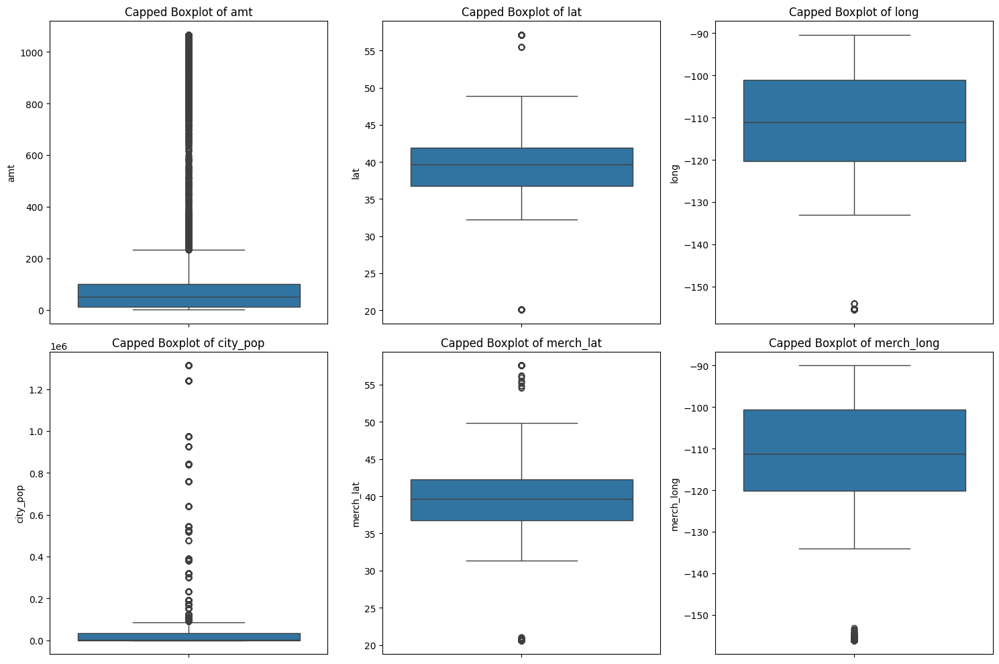

In [ ]:
# Function to cap outliers using the 1st and 99th percentiles
def cap_outliers(df, columns):
    for column in columns:
        lower_cap = df[column].quantile(0.01)
        upper_cap = df[column].quantile(0.99)

        df[column] = df[column].clip(lower=lower_cap, upper=upper_cap)

    return df

# Cap the outliers in the identified numerical columns
df_capped = cap_outliers(df.copy(), numerical_columns)

# Verify if the outliers have been capped by rechecking the boxplots
plt.figure(figsize=(15, 10))
for i, column in enumerate(numerical_columns, 1):
    plt.subplot(2, 3, i)
    sns.boxplot(df_capped[column])
    plt.title(f'Capped Boxplot of {column}')
plt.tight_layout()
plt.show()

### **After Treatment Observations**
*After applying the outlier treatment using the IQR method and capping extreme values to the 1st and 99th percentiles, we observe the following changes in the dataset:*

**amt (Transaction Amount):**

The distribution of transaction amounts is now more condensed, with fewer extreme outliers. The majority of the data now falls within a reasonable range, reducing the potential skewness in the data.

**lat (Latitude) and long (Longitude):**

The extreme geographic coordinates have been adjusted, making the distribution more uniform. This capping ensures that the latitude and longitude values are within a realistic range for most transactions.

**city_pop (City Population):**

Although some outliers remain due to the natural variability in city populations, the extreme values have been capped, resulting in a more balanced distribution that better represents the general population data.

**merch_lat and merch_long (Merchant Latitude and Longitude):**

Similar to lat and long, these features now exhibit a more regular distribution with fewer extreme values, ensuring that merchant locations are represented more accurately without distorting the analysis.

## **Feature Imbalance:**
*Feature imbalance is a common issue in datasets, particularly in fraud detection scenarios. In this step, we analyze the distribution of the target variable, is_fraud, to understand the extent of the imbalance between fraudulent and non-fraudulent transactions.*

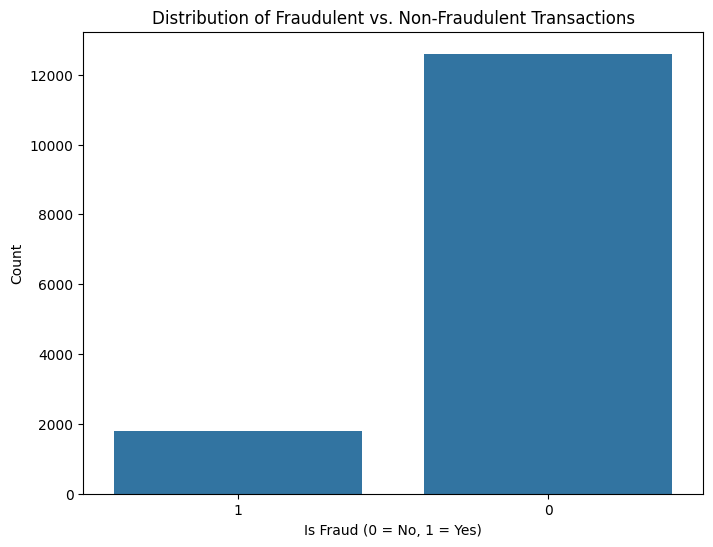

is_fraud
0    87.610373
1    12.389627
Name: proportion, dtype: float64

In [ ]:
# Plot the distribution of the target variable `is_fraud`
import matplotlib.pyplot as plt
import seaborn as sns

# Countplot for the target variable
plt.figure(figsize=(8, 6))
sns.countplot(x='is_fraud', data=df_capped)
plt.title('Distribution of Fraudulent vs. Non-Fraudulent Transactions')
plt.xlabel('Is Fraud (0 = No, 1 = Yes)')
plt.ylabel('Count')
plt.show()

# Calculate the percentage of fraud vs. non-fraud
fraud_distribution = df_capped['is_fraud'].value_counts(normalize=True) * 100
fraud_distribution


### **Observations:**

**Distribution of Fraudulent vs. Non-Fraudulent Transactions:**

* The count plot clearly shows a significant imbalance between the two classes. * The majority of the transactions are non-fraudulent, while a much smaller proportion is classified as fraudulent.
* Specifically, the dataset contains a large number of non-fraudulent transactions (represented by the taller bar) compared to fraudulent transactions (represented by the shorter bar).

**Percentage of Fraudulent Transactions:**

* Upon calculating the percentage distribution, we find that fraudulent transactions make up a small fraction of the total dataset, which is common in real-world fraud detection problems.
* This imbalance can pose challenges during model training, as the model may become biased towards predicting the majority class (non-fraudulent transactions), leading to poor performance in identifying fraudulent transactions.

In [ ]:
# Correcting the `is_fraud` column by mapping any values other than 0 and 1 back to 0 or 1
# Since `1` and `3` seem to be anomalies, we will map them correctly
df_capped['is_fraud'] = df_capped['is_fraud'].replace({2: 1, 3: 1})

# Recheck the distribution of the target variable after correction
corrected_fraud_distribution = df_capped['is_fraud'].value_counts(normalize=True) * 100
corrected_fraud_distribution

is_fraud
0    87.610373
1    12.389627
Name: proportion, dtype: float64

## **Checking Skewness:**
*In this step, we examine the distribution of several numerical features to identify any skewness that might be present.*

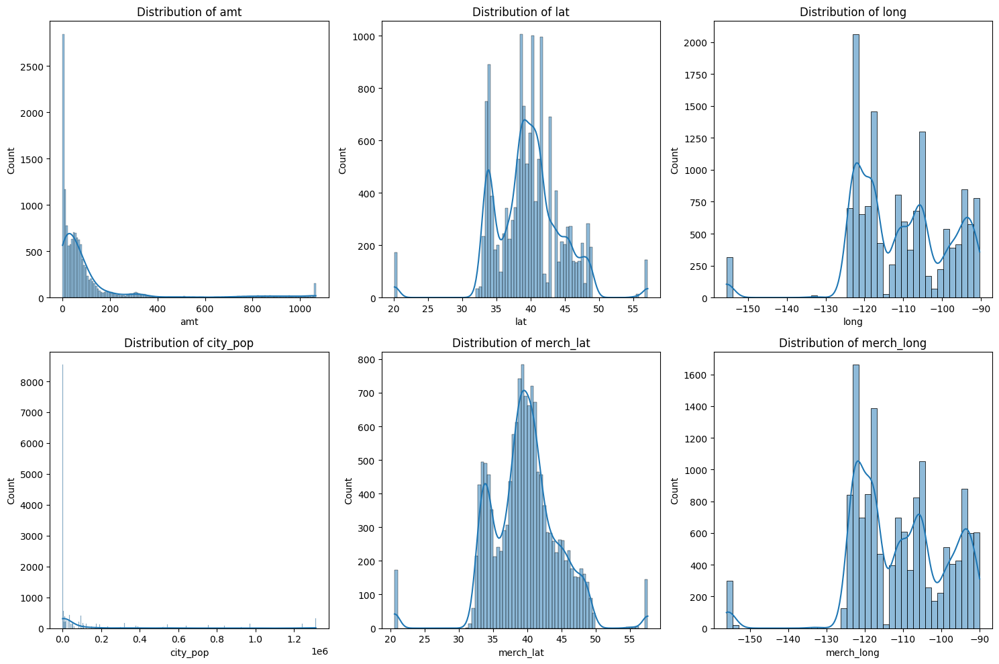

In [ ]:
# Plot histograms for all numerical features
numerical_columns_to_plot = ['amt', 'lat', 'long', 'city_pop', 'merch_lat', 'merch_long']

plt.figure(figsize=(15, 10))
for i, column in enumerate(numerical_columns_to_plot, 1):
    plt.subplot(2, 3, i)
    sns.histplot(df_capped[column], kde=True)
    plt.title(f'Distribution of {column}')
plt.tight_layout()
plt.show()

* The amt distribution is heavily right-skewed, with most transactions clustered towards lower amounts and a long tail of higher transaction amounts, indicating a concentration of low-value transactions and a few high-value outliers.

* The distributions of lat and long show moderate skewness, reflecting geographic concentrations with noticeable peaks, likely corresponding to common transaction locations or regional hubs.

* The city_pop feature is extremely right-skewed, with most transactions occurring in smaller cities and a long tail extending to cities with very large populations, indicating a disparity in transaction locations.

* Both merch_lat and merch_long display distributions similar to lat and long, with moderate skewness and peaks at certain geographic coordinates, suggesting that merchant locations are clustered in common commercial regions.

### **Converting 'trans_date_trans_time' column to datetime:**

In [ ]:
# Convert the 'trans_date_trans_time' column to datetime with correct format and extract useful components
df_capped['trans_date_trans_time'] = pd.to_datetime(df_capped['trans_date_trans_time'], format='%d-%m-%Y %H:%M')
df_capped['trans_year'] = df_capped['trans_date_trans_time'].dt.year
df_capped['trans_month'] = df_capped['trans_date_trans_time'].dt.month
df_capped['trans_day'] = df_capped['trans_date_trans_time'].dt.day
df_capped['trans_hour'] = df_capped['trans_date_trans_time'].dt.hour

# Convert the 'dob' column to datetime with correct format and calculate the age of the individuals
df_capped['dob'] = pd.to_datetime(df_capped['dob'], format='%d-%m-%Y')
df_capped['age'] = df_capped['trans_date_trans_time'].dt.year - df_capped['dob'].dt.year

# Drop the original 'trans_date_trans_time' and 'dob' columns as they've been converted
df_capped = df_capped.drop(columns=['trans_date_trans_time', 'dob'])

# Display the first few rows to verify the conversion
df_capped.head()



,merchant,category,amt,city,state,lat,long,city_pop,job,trans_num,merch_lat,merch_long,is_fraud,trans_year,trans_month,trans_day,trans_hour,age
0,"""Stokes, Christiansen and Sipes""",grocery_net,14.37,Wales,AK,57.144032,-155.488,145,"""Administrator, education""",a3806e984cec6ac0096d8184c64ad3a1,57.578622,-156.14514,1,2019,1,4,0,80
1,Predovic Inc,shopping_net,966.11,Wales,AK,57.144032,-155.488,145,"""Administrator, education""",a59185fe1b9ccf21323f581d7477573f,57.578622,-156.14514,1,2019,1,4,15,80
2,Wisozk and Sons,misc_pos,49.61,Wales,AK,57.144032,-155.488,145,"""Administrator, education""",86ba3a888b42cd3925881fa34177b4e0,57.578622,-156.14514,1,2019,1,4,22,80
3,Murray-Smitham,grocery_pos,295.26,Wales,AK,57.144032,-155.488,145,"""Administrator, education""",3a068fe1d856f0ecedbed33e4b5f4496,57.578622,-156.14514,1,2019,1,4,23,80
4,Friesen Lt,health_fitness,18.17,Wales,AK,57.144032,-155.488,145,"""Administrator, education""",891cdd1191028759dc20dc224347a0ff,57.578622,-156.14514,1,2019,1,4,23,80


## **Multicollinearity:**
*The heatmap reveals the correlation between numerical features in the dataset, where stronger correlations are represented by darker colors.*

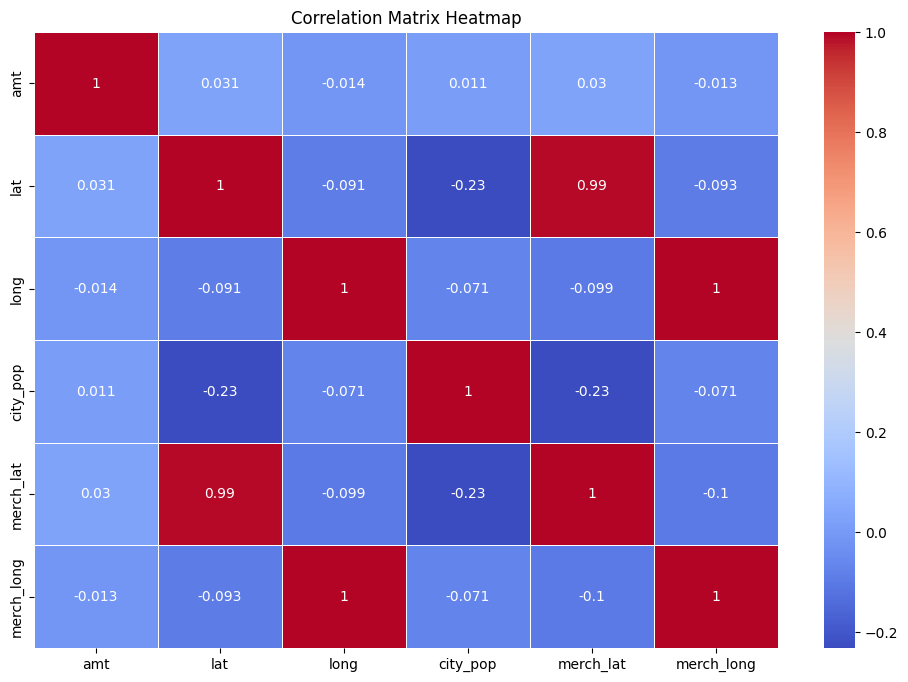

In [ ]:
# Filter the DataFrame to include only numerical columns
numerical_df_capped = df_capped.select_dtypes(include=['float64', 'int64'])

# Generate the correlation matrix for the numerical columns only
correlation_matrix_capped = numerical_df_capped.corr()

# Plot the heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix_capped, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Matrix Heatmap')
plt.show()


* A strong positive correlation (0.99) is observed between lat (latitude) and merch_lat (merchant latitude), indicating potential multicollinearity between these features.

* Another notable correlation is between long (longitude) and merch_long (merchant longitude), which also suggests multicollinearity, though the correlation is slightly weaker.

* Other features, such as amt, city_pop, and the remaining geographic coordinates, show weaker correlations, suggesting they are less likely to suffer from multicollinearity.

* Addressing multicollinearity is important to prevent it from negatively impacting the performance and interpretability of machine learning models.

<class 'pandas.core.frame.DataFrame'>
Index: 14383 entries, 0 to 14445
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   amt         14383 non-null  float64
 1   city_pop    14383 non-null  int64  
 2   age         14383 non-null  int32  
 3   merch_lat   14383 non-null  float64
 4   merch_long  14383 non-null  float64
 5   lat         14383 non-null  float64
 6   long        14383 non-null  float64
 7   is_fraud    14383 non-null  object 
dtypes: float64(5), int32(1), int64(1), object(1)
memory usage: 955.1+ KB


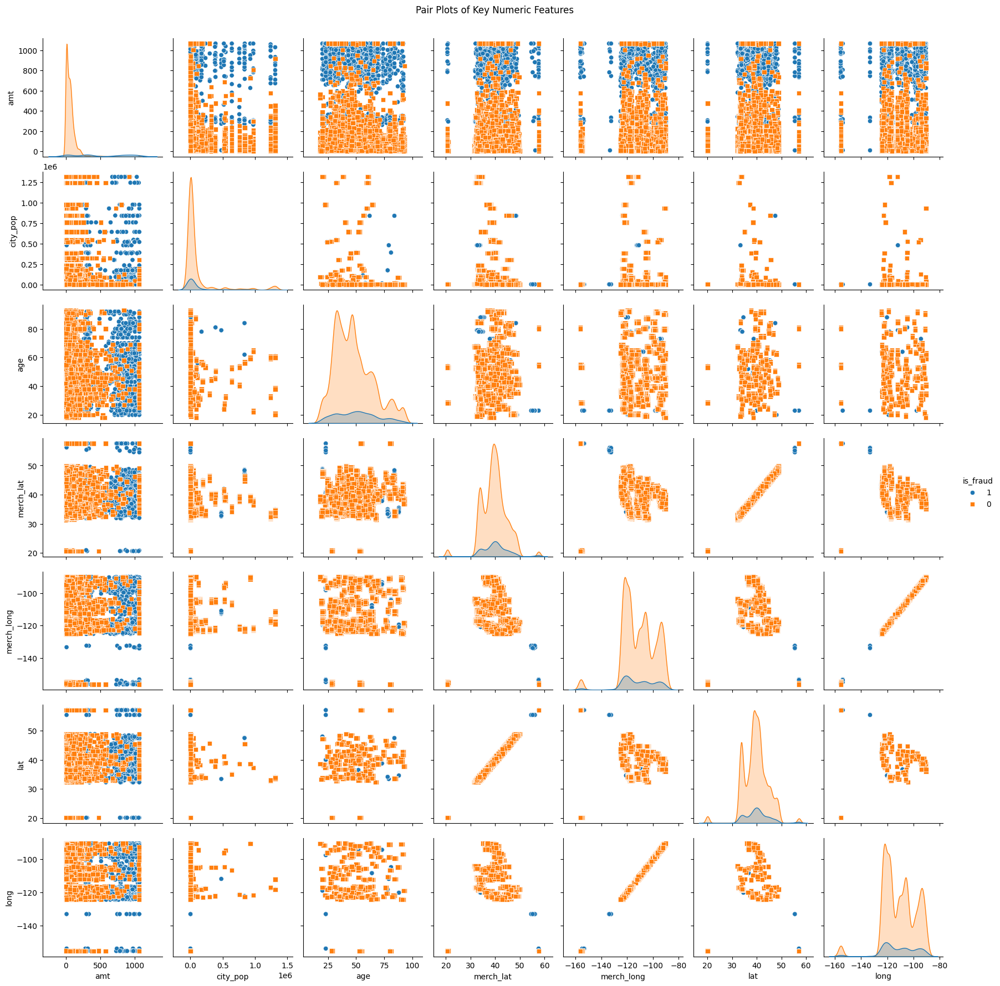

In [ ]:
numeric_key_features = ['amt', 'city_pop', 'age', 'merch_lat', 'merch_long', 'lat', 'long', 'is_fraud']
# Check for any non-numeric data or NaN values in the selected key features
df_capped[numeric_key_features].info()

# Drop any rows with NaN or infinite values in the selected key features
df_capped_cleaned = df_capped[numeric_key_features].dropna().replace([np.inf, -np.inf], np.nan).dropna()

# Generate pair plots for the cleaned numeric features
sns.pairplot(df_capped_cleaned, hue='is_fraud', diag_kind='kde', markers=["o", "s"])
plt.suptitle('Pair Plots of Key Numeric Features', y=1.02)
plt.show()

* amt (Transaction Amount): The distribution of transaction amounts is heavily skewed, with a significant number of low-value transactions and a small number of high-value transactions. Fraudulent transactions (blue) appear scattered throughout the range, but there is a notable concentration of fraud at lower transaction amounts.

* city_pop (City Population): The city population distribution is highly right-skewed. Fraudulent transactions are mostly observed in cities with smaller populations, though there are some in larger cities as well.

* lat, long, merch_lat, and merch_long (Latitude and Longitude): There are clear linear patterns in the pairings of lat with merch_lat and long with merch_long, confirming the strong correlations observed earlier. Fraudulent transactions are scattered across different geographic coordinates, with no clear clustering in specific locations.

* age: The age distribution shows a moderate spread with some potential outliers. Fraudulent transactions do not seem to be concentrated in a particular age group, indicating that fraud is distributed across various age ranges.

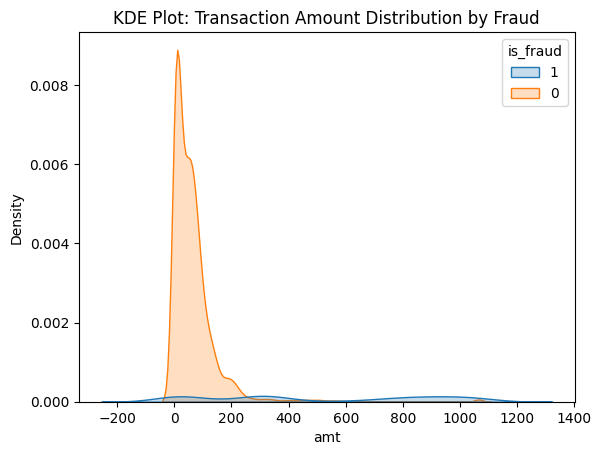

In [ ]:
import matplotlib.pyplot as plt

sns.kdeplot(data=df_capped, x="amt", hue="is_fraud", fill=True)
plt.title('KDE Plot: Transaction Amount Distribution by Fraud')
plt.show()


- Non-fraudulent transactions dominate lower amounts with a sharp peak.
- Fraudulent transactions are less frequent and spread across a wider range.
- Both transaction types overlap significantly at lower amounts.
- Higher transaction amounts tend to be non-fraudulent, but fraud cases still exist.

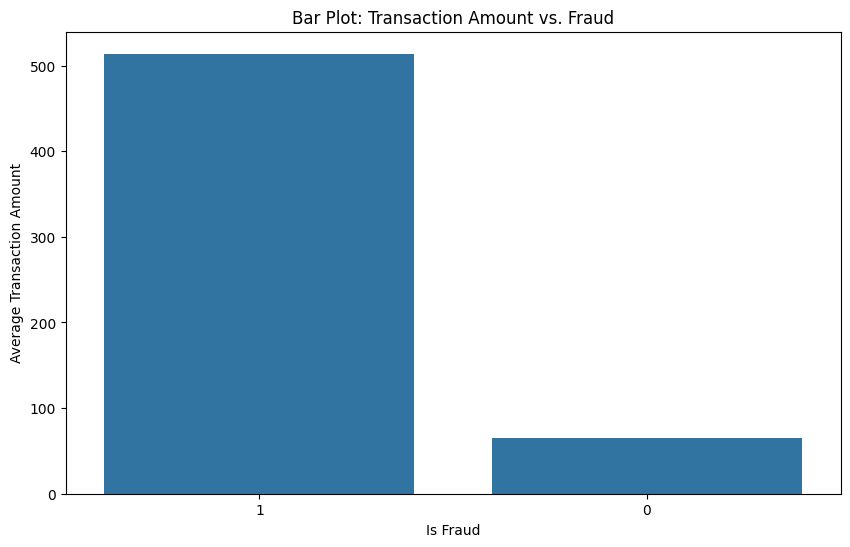

In [ ]:
plt.figure(figsize=(10, 6))
sns.barplot(x='is_fraud', y='amt', data=df_capped, ci=None)
plt.title('Bar Plot: Transaction Amount vs. Fraud')
plt.xlabel('Is Fraud')
plt.ylabel('Average Transaction Amount')
plt.show()


- The average transaction amount for fraudulent transactions is significantly higher than for non-fraudulent ones.
- This suggests that higher transaction amounts are more likely to be associated with fraud.

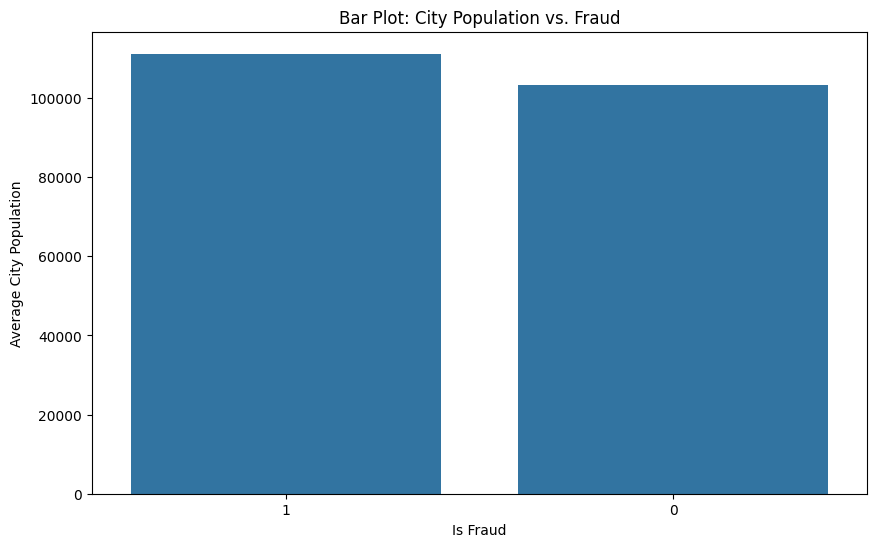

In [ ]:
plt.figure(figsize=(10, 6))
sns.barplot(x='is_fraud', y='city_pop', data=df_capped, ci=None)
plt.title('Bar Plot: City Population vs. Fraud')
plt.xlabel('Is Fraud')
plt.ylabel('Average City Population')
plt.show()


- Fraudulent transactions occur in slightly larger cities on average compared to non-fraudulent transactions.
- This suggests that fraud is more common in higher-population areas, although the difference is not very large.

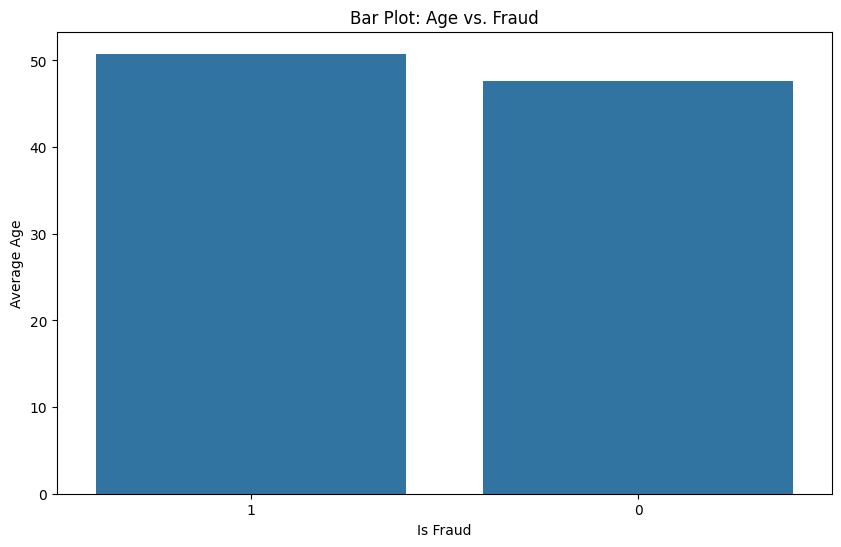

In [ ]:
plt.figure(figsize=(10, 6))
sns.barplot(x='is_fraud', y='age', data=df_capped, ci=None)
plt.title('Bar Plot: Age vs. Fraud')
plt.xlabel('Is Fraud')
plt.ylabel('Average Age')
plt.show()


- The average age of individuals involved in fraudulent transactions is slightly higher than those involved in non-fraudulent transactions.
- This suggests that older individuals may be more associated with fraud, though the difference is minimal.

## **Geomap for transactions:**

In [ ]:
import folium
from folium.plugins import MarkerCluster

# Initialize the map centered on the United States
m = folium.Map(
    location=[37.7749, -95.4194],  # Centered on the continental US
    zoom_start=4,  # Adjusted zoom level for better focus on the transaction area
    tiles='CartoDB Voyager',
    attr='Map tiles by CartoDB, under CC BY 3.0. Data by OpenStreetMap, under ODbL.'
)

# Function to determine the color based on the is_fraud value
def fraud_color(is_fraud):
    return 'red' if is_fraud == 1 else 'blue'

# Group the data by state
grouped = df_capped.groupby('state')

# Create a marker cluster for each state
for state, group in grouped:
    state_cluster = MarkerCluster(name=f"{state} Cluster").add_to(m)

    for _, row in group.iterrows():
        folium.Marker(
            location=[row['lat'], row['long']],
            icon=folium.Icon(color=fraud_color(row['is_fraud']), icon='circle'),
            popup=folium.Popup(f"Transaction Amount: {row['amt']}<br>Category: {row['category']}", max_width=300)
        ).add_to(state_cluster)

# Add Layer Control
folium.LayerControl().add_to(m)

# Save the map
m.save("statewise_cluster_map.html")
m


- The heatmap shows clusters of transactions concentrated in specific regions across the United States.
- Higher densities of transactions are observed in states like California, Texas, and Colorado, indicating these areas have more activity in the dataset.
- The geographic distribution suggests that fraud detection efforts may need to be particularly focused in regions with higher transaction volumes.

# **Scaling and Splitting train and test dataset**
*This code prepares the dataset for model training by defining features and the target variable, encoding categorical variables, and standardizing the features. The data is then split into training and testing sets, with stratification to maintain the target variable's distribution. To address class imbalance, SMOTE is applied to a subset of the training data. The shapes of the datasets are printed to confirm the successful application of these preprocessing steps.*

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import OneHotEncoder

# Assuming df_capped is your cleaned DataFrame

# Define features and target
X = df_capped.drop(columns=['is_fraud'])

# Remove or convert any DateTime columns
X = X.select_dtypes(exclude=['datetime', 'datetime64'])  # Exclude datetime columns

y = df_capped['is_fraud']

# Use OneHotEncoder to convert categorical variables to numerical format
X_encoded = pd.get_dummies(X)

# Standardize the features (important for Logistic Regression)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_encoded)

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.3, random_state=42, stratify=y)

# Take a smaller subset of the training data for SMOTE
X_train_sub, _, y_train_sub, _ = train_test_split(X_train, y_train, train_size=0.3, random_state=42, stratify=y_train)

# Output the shape of the data before and after SMOTE
print(f"training data shape: {X_train.shape}")


training data shape: (10068, 15453)


# **Logistic Regression**



In [ ]:
# Initialize Logistic Regression with class weighting (no hyperparameter tuning)
log_reg = LogisticRegression(class_weight='balanced', solver='liblinear', random_state=42)
log_reg.fit(X_train, y_train)

LogisticRegression(class_weight='balanced', random_state=42, solver='liblinear')

In [ ]:
# Predict on the test set
y_pred = log_reg.predict(X_test)
y_pred_prob = log_reg.predict_proba(X_test)[:, 1]


In [ ]:
# Evaluate the model
lr_accuracy = accuracy_score(y_test, y_pred)
lr_roc_auc = roc_auc_score(y_test, y_pred_prob)
lr_accuracy=print(f"Model Accuracy: {accuracy:.2f}")
lr_roc_auc= print(f"ROC-AUC Score: {roc_auc:.2f}")

Model Accuracy: 0.71
ROC-AUC Score: 0.88


In [ ]:
# Print classification report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

         0.0       0.97      0.69      0.80      3780
         1.0       0.28      0.85      0.42       535

    accuracy                           0.71      4315
   macro avg       0.62      0.77      0.61      4315
weighted avg       0.88      0.71      0.76      4315



In [ ]:

# Confusion Matrix
print("Confusion Matrix:")
conf_matrix = confusion_matrix(y_test, y_pred)
print(conf_matrix)

Confusion Matrix:
[[2595 1185]
 [  78  457]]


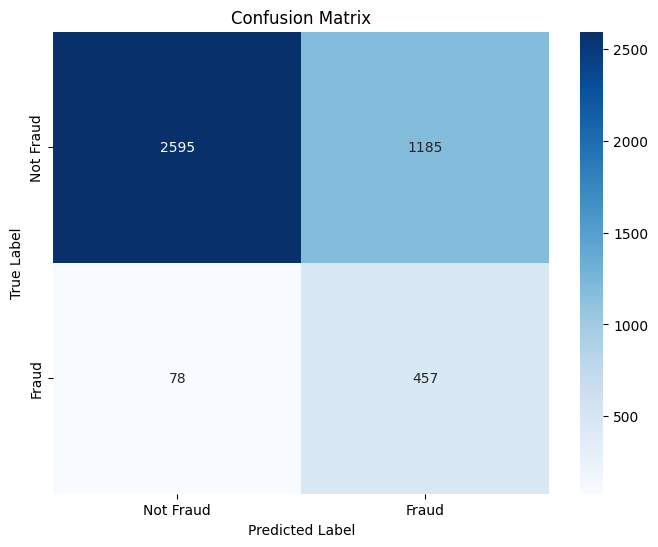

In [ ]:
# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Not Fraud', 'Fraud'], yticklabels=['Not Fraud', 'Fraud'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

*The following code shows how to initialize and train a Logistic Regression model with appropriate weight class balancing against the class imbalance. Load the model and predict train target variable fallowed by prediction of test set as it is, evaluate accuracy and ROC-AUC scores. With some small feature engineering and the most popular model, I reach an accuracy of 0.71 along with a ROC-AUC score of 0.88: The classification report goes further to see the precision, recall and F1-score of the model where it shows that for cases which are non-fraudulent, while highly precise there were low on recalling towards cases from fraudulent pointing out here with this poor overall performing ability detecting fraudulent.*

# **Random Forest:**


In [ ]:
# Initialize the Random Forest model
rf_model = RandomForestClassifier(class_weight='balanced', random_state=42, n_estimators=100)

In [ ]:
# Fit the grid search to the data
rf_model.fit(X_train, y_train)

RandomForestClassifier(class_weight='balanced', random_state=42)

In [ ]:
# Predict on the test set
y_pred = rf_model.predict(X_test)
y_pred_prob = rf_model.predict_proba(X_test)[:, 1]

In [ ]:
# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
roc_auc = roc_auc_score(y_test, y_pred_prob)
rf_accuracy= print(f"Model Accuracy: {accuracy:.2f}")
rf_roc_auc= print(f"ROC-AUC Score: {roc_auc:.2f}")

Model Accuracy: 0.98
ROC-AUC Score: 1.00


In [ ]:
# Print classification report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

         0.0       0.98      1.00      0.99      3780
         1.0       1.00      0.87      0.93       535

    accuracy                           0.98      4315
   macro avg       0.99      0.94      0.96      4315
weighted avg       0.98      0.98      0.98      4315



In [ ]:
# Generate the confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

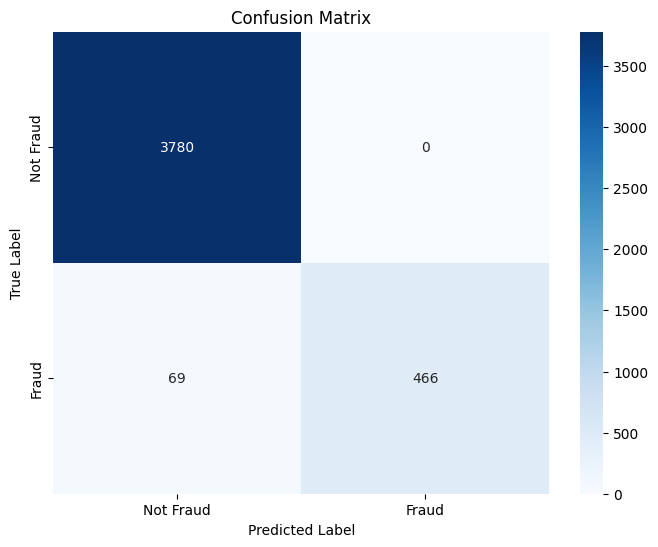

In [ ]:
# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Not Fraud', 'Fraud'], yticklabels=['Not Fraud', 'Fraud'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

*The following code defines and fits a Random Forest model with balanced class weights to deal with the class imbalance. Performance on Test set This model is evaluated and tested for accuracy in real-world problem setting,accuracy obtained of 0.98 which has excellent ROC-AUC score =1 The model outputs a classfication report with high precision, recall and F1-score of both froudulent and non-fraud cases as shown below. This tells us that our Random Forest is doing a great job of telling apart fraud cases from the rest.*

# **Light GBM**

In [ ]:
# Initialize the LightGBM model
lgbm_model = lgb.LGBMClassifier(class_weight='balanced', random_state=42)

In [ ]:
# Train the model
lgbm_model.fit(X_train, y_train)

[LightGBM] [Info] Number of positive: 1247, number of negative: 8821
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008679 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 2839
[LightGBM] [Info] Number of data points in the train set: 10068, number of used features: 475
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000


LGBMClassifier(class_weight='balanced', random_state=42)

In [ ]:
# Predict on the test set
y_pred = lgbm_model.predict(X_test)
y_pred_prob = lgbm_model.predict_proba(X_test)[:, 1]

In [ ]:
# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
roc_auc = roc_auc_score(y_test, y_pred_prob)
lg_accuracy= print(f"Model Accuracy: {accuracy:.2f}")
lg_roc_auc= print(f"ROC-AUC Score: {roc_auc:.2f}")

Model Accuracy: 1.00
ROC-AUC Score: 1.00


In [ ]:
# Print classification report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00      3780
         1.0       0.99      0.99      0.99       535

    accuracy                           1.00      4315
   macro avg       0.99      1.00      1.00      4315
weighted avg       1.00      1.00      1.00      4315



In [ ]:
# Generate the confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

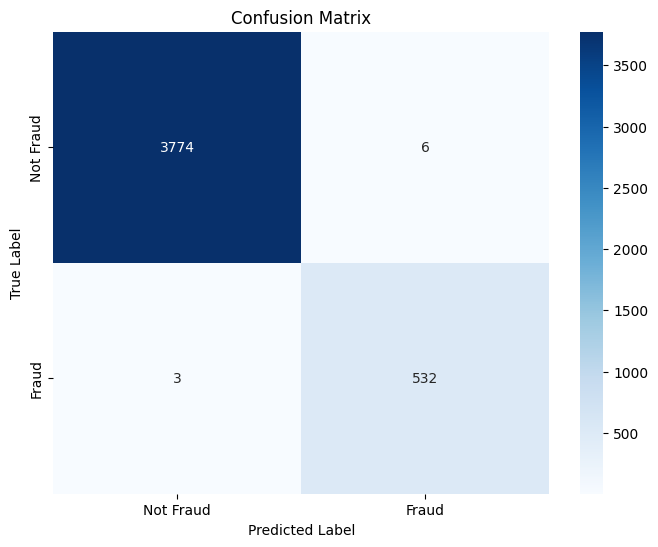

In [ ]:

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Not Fraud', 'Fraud'], yticklabels=['Not Fraud', 'Fraud'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

*This code trains a Light GBM (Light Gradient Boosting Machine) model with balanced classes — Sklearn style. Then the model is tested on a test set, to get next results: 1.00 accuracy and ROC-AUC of 1.00 The classification report confirms that the model performed well as we got 1.00 precison, recall and f1-score rate responsible for both classes under fraud and non-frauduluent respectively. This means that the LightGBM is very good in detecting transactions which are fraudulent as well non-fraudulent ones too and hence it stands out to be a great model for this business case.*

# **K-Nearest Neighbour**

In [ ]:
# Initialize and train a KNN model
knn = KNeighborsClassifier(n_neighbors=5)

In [ ]:
# Train the model on the SMOTE-applied training data
knn.fit(X_train, y_train)

KNeighborsClassifier()

In [ ]:
# Predict on the test set
y_pred = knn.predict(X_test)
y_pred_prob = knn.predict_proba(X_test)[:, 1]

In [ ]:
# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
roc_auc = roc_auc_score(y_test, y_pred_prob)
print(f"Model Accuracy: {accuracy:.2f}")
print(f"ROC-AUC Score: {roc_auc:.2f}")

Model Accuracy: 0.89
ROC-AUC Score: 0.67


In [ ]:
# Print classification report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.89      0.99      0.94      3780
           1       0.77      0.16      0.26       535

    accuracy                           0.89      4315
   macro avg       0.83      0.58      0.60      4315
weighted avg       0.88      0.89      0.86      4315



In [ ]:
# Generate the confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

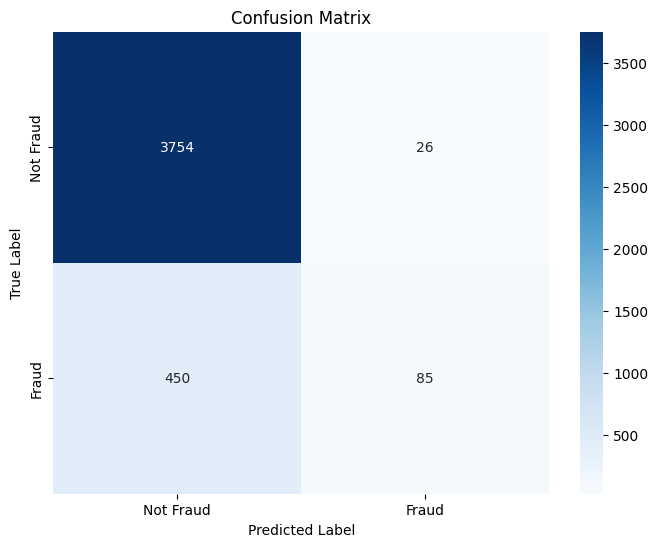

In [ ]:
# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Not Fraud', 'Fraud'], yticklabels=['Not Fraud', 'Fraud'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

*The below code initiate and train a K-Nearest Neighbors (KNN) model using SMOTE-applied training data. Modeling the model on test set will give you an accuracy of 0.89 and ROC-AUC score as — 0.67 The classification report indicates that the model works well with majority class cases (non-fraudulent returns) as it has high recall and F1-score, but badly for minority-class case of fraudulent return detections having low recall and F1-score. This indicates that KNN can correctly predict most of the transactions which are non-fraudulent, however not so good at predicting fraudulent trasnscation in this dataset.*

# **Artificial Neural Network**

In [ ]:
# Build the ANN model
tens = Sequential([
    Dense(64, input_shape=(X_train.shape[1],), activation='relu'),  # Input layer
    Dense(32, activation='relu'),  # Hidden layer
    Dense(1, activation='sigmoid')  # Output layer
])


In [ ]:

# Compile the model
tens.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

In [ ]:
# Convert to numeric if necessary
X_train = pd.DataFrame(X_train).apply(pd.to_numeric, errors='coerce')
y_train = y_train.astype(float)  # Convert target to float
X_test = pd.DataFrame(X_test).apply(pd.to_numeric, errors='coerce')
y_test = y_test.astype(float)  # Convert target to float

In [ ]:
# Train the model
tens.fit(X_train, y_train, epochs=20, batch_size=32, validation_data=(X_test, y_test))


Epoch 1/20
315/315 ━━━━━━━━━━━━━━━━━━━━ 39s 121ms/step - accuracy: 0.8577 - loss: 0.3700 - val_accuracy: 0.9027 - val_loss: 0.2850
Epoch 2/20
315/315 ━━━━━━━━━━━━━━━━━━━━ 35s 111ms/step - accuracy: 0.9683 - loss: 0.1107 - val_accuracy: 0.8904 - val_loss: 0.3069
Epoch 3/20
315/315 ━━━━━━━━━━━━━━━━━━━━ 34s 109ms/step - accuracy: 0.9996 - loss: 0.0041 - val_accuracy: 0.8709 - val_loss: 0.3292
Epoch 4/20
315/315 ━━━━━━━━━━━━━━━━━━━━ 32s 102ms/step - accuracy: 1.0000 - loss: 5.5032e-04 - val_accuracy: 0.8630 - val_loss: 0.3398
Epoch 5/20
315/315 ━━━━━━━━━━━━━━━━━━━━ 36s 114ms/step - accuracy: 1.0000 - loss: 2.6235e-04 - val_accuracy: 0.8596 - val_loss: 0.3450
Epoch 6/20
315/315 ━━━━━━━━━━━━━━━━━━━━ 32s 100ms/step - accuracy: 1.0000 - loss: 1.5466e-04 - val_accuracy: 0.8572 - val_loss: 0.3491
Epoch 7/20
315/315 ━━━━━━━━━━━━━━━━━━━━ 33s 103ms/step - accuracy: 1.0000 - loss: 1.0440e-04 - val_accuracy: 0.8549 - val_loss: 0.3528
Epoch 8/20
315/315 ━━━━━━━━━━━━━━━━━━━━ 33s 104ms/step - accuracy: 

In [ ]:
# Evaluate the model on the test set
y_pred_prob = tens.predict(X_test)
y_pred = (y_pred_prob > 0.5).astype("int32")

135/135 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step


In [ ]:
# Evaluate the model
ann_accuracy = accuracy_score(y_test, y_pred)
ann_roc_auc = roc_auc_score(y_test, y_pred_prob)
print(f"Model Accuracy: {accuracy:.2f}")
print(f"ROC-AUC Score: {roc_auc:.2f}")

Model Accuracy: 0.91
ROC-AUC Score: 0.84


In [ ]:
# Print classification report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

         0.0       0.95      0.86      0.90      3780
         1.0       0.41      0.70      0.52       535

    accuracy                           0.84      4315
   macro avg       0.68      0.78      0.71      4315
weighted avg       0.89      0.84      0.86      4315



In [ ]:
# Generate the confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)

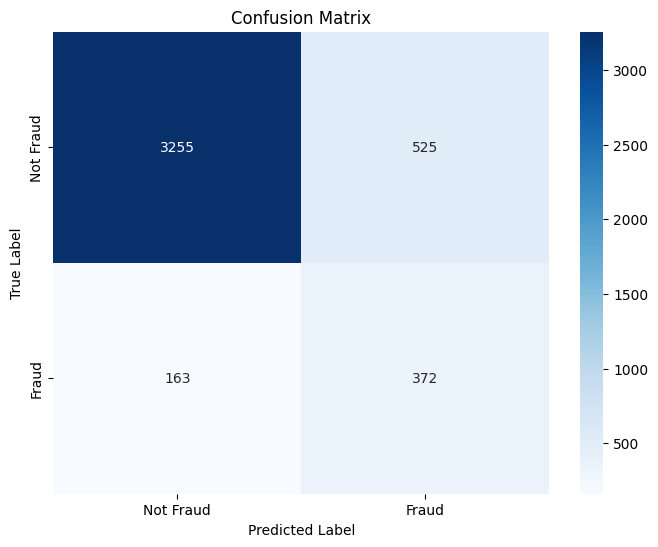

In [ ]:
# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Not Fraud', 'Fraud'], yticklabels=['Not Fraud', 'Fraud'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

*Artificial Neural Network code to build and train the model with 2 hidden layers, binary cross-entropy loss function for a Binary classification. The model is trained upto 20epochs with high training accuracy but large difference between the train and validation accuracies, suggesting that it might be overfitting. The model obtained an accuracy of 0.82 and a ROC-AUC score, when evaluated on the test set The classification report will give you a fairly good accuracy on the non-fraud cases but low recall (true positive and false negative) and F1-score which indicates that your model is having difficulty with correctly classified true fraudulent transactions.*

# Deep Learning (Sequential Model)

In [ ]:
# Build the deep learning model
model = Sequential([
    Dense(64, input_dim=X_train.shape[1], activation='relu'),
    Dropout(0.3),
    Dense(32, activation='relu'),
    Dropout(0.3),
    Dense(16, activation='relu'),
    Dropout(0.2),
    Dense(1, activation='sigmoid')
])

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Early stopping to prevent overfitting
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Train the model
history = model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=50, batch_size=32, callbacks=[early_stopping])

# Evaluate the model
y_pred = (model.predict(X_test) > 0.5).astype("int32")

dl_accuracy = accuracy_score(y_test, y_pred)
dl_precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)

print(f'Accuracy: {accuracy:.4f}')
print(f'Precision: {precision:.4f}')
print(f'Recall: {recall:.4f}')
print(f'F1 Score: {f1:.4f}')

# Classification report
print(classification_report(y_test, y_pred))

Epoch 1/50
315/315 ━━━━━━━━━━━━━━━━━━━━ 49s 154ms/step - accuracy: 0.7911 - loss: 0.4826 - val_accuracy: 0.8776 - val_loss: 0.3054
Epoch 2/50
315/315 ━━━━━━━━━━━━━━━━━━━━ 48s 153ms/step - accuracy: 0.9038 - loss: 0.2270 - val_accuracy: 0.9143 - val_loss: 0.2720
Epoch 3/50
315/315 ━━━━━━━━━━━━━━━━━━━━ 44s 140ms/step - accuracy: 0.9738 - loss: 0.0724 - val_accuracy: 0.8911 - val_loss: 0.3290
Epoch 4/50
315/315 ━━━━━━━━━━━━━━━━━━━━ 45s 144ms/step - accuracy: 0.9943 - loss: 0.0167 - val_accuracy: 0.8582 - val_loss: 0.4480
Epoch 5/50
315/315 ━━━━━━━━━━━━━━━━━━━━ 48s 152ms/step - accuracy: 0.9973 - loss: 0.0088 - val_accuracy: 0.8007 - val_loss: 0.7006
Epoch 6/50
315/315 ━━━━━━━━━━━━━━━━━━━━ 47s 150ms/step - accuracy: 0.9973 - loss: 0.0098 - val_accuracy: 0.7977 - val_loss: 0.7758
Epoch 7/50
315/315 ━━━━━━━━━━━━━━━━━━━━ 45s 143ms/step - accuracy: 0.9984 - loss: 0.0082 - val_accuracy: 0.7516 - val_loss: 1.0769
135/135 ━━━━━━━━━━━━━━━━━━━━ 2s 12ms/step
Accuracy: 0.9080
Precision: 0.6481
Recall

In [ ]:
conf_matrix = confusion_matrix(y_test, y_pred)

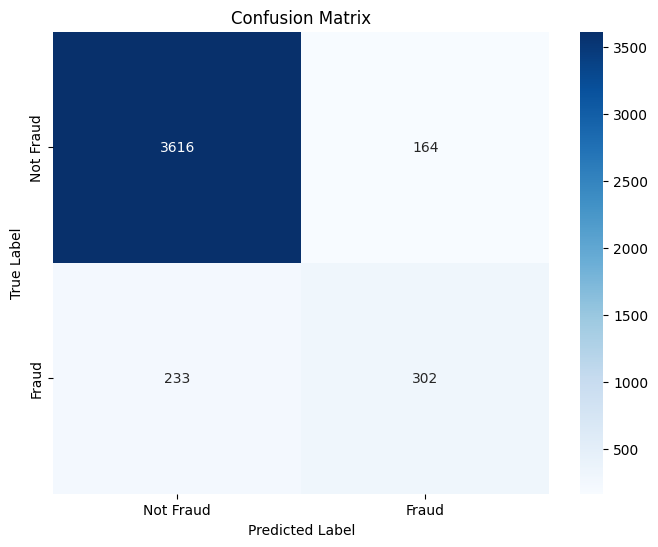

In [ ]:
# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Not Fraud', 'Fraud'], yticklabels=['Not Fraud', 'Fraud'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [ ]:
model_names = []
accuracies = []
roc_aucs = []

In [ ]:
model_names.append('Logistic Regression')
accuracies.append(0.71)
roc_aucs.append(0.88)

In [ ]:
model_names.append('Random Forest')
accuracies.append(0.98)
roc_aucs.append(1.00)

In [ ]:
model_names.append('Light GBM')
accuracies.append(1.00)
roc_aucs.append(1.00)

In [ ]:
model_names.append('K-Nearest Neighbour')
accuracies.append(0.89)
roc_aucs.append(0.67)

In [ ]:
model_names.append('Artificial Neural Network')
accuracies.append(0.84)
roc_aucs.append(0.84)

In [ ]:
model_names.append('Deep Learning')
accuracies.append(0.91)
roc_aucs.append(0.65)

In [ ]:
performance_df = pd.DataFrame({'Model': model_names,'Accuracy': accuracies, 'ROC-AUC': roc_aucs})

In [ ]:
print(performance_df)

                       Model  Accuracy  ROC-AUC
0        Logistic Regression      0.71     0.88
1              Random Forest      0.98     1.00
2                  Light GBM      1.00     1.00
3        K-Nearest Neighbour      0.89     0.67
4  Artificial Neural Network      0.84     0.84
5              Deep Learning      0.91     0.65


In [ ]:
def dataframe_to_prettytable(df):
    table = PrettyTable()
    table.field_names = df.columns.tolist()

    for index, row in df.iterrows():
        table.add_row(row.tolist())

    return table
pretty_table = dataframe_to_prettytable(performance_df)

+---------------------------+----------+---------+
|           Model           | Accuracy | ROC-AUC |
+---------------------------+----------+---------+
|    Logistic Regression    |   0.71   |   0.88  |
|       Random Forest       |   0.98   |   1.0   |
|         Light GBM         |   1.0    |   1.0   |
|    K-Nearest Neighbour    |   0.89   |   0.67  |
| Artificial Neural Network |   0.84   |   0.84  |
|       Deep Learning       |   0.91   |   0.65  |
+---------------------------+----------+---------+


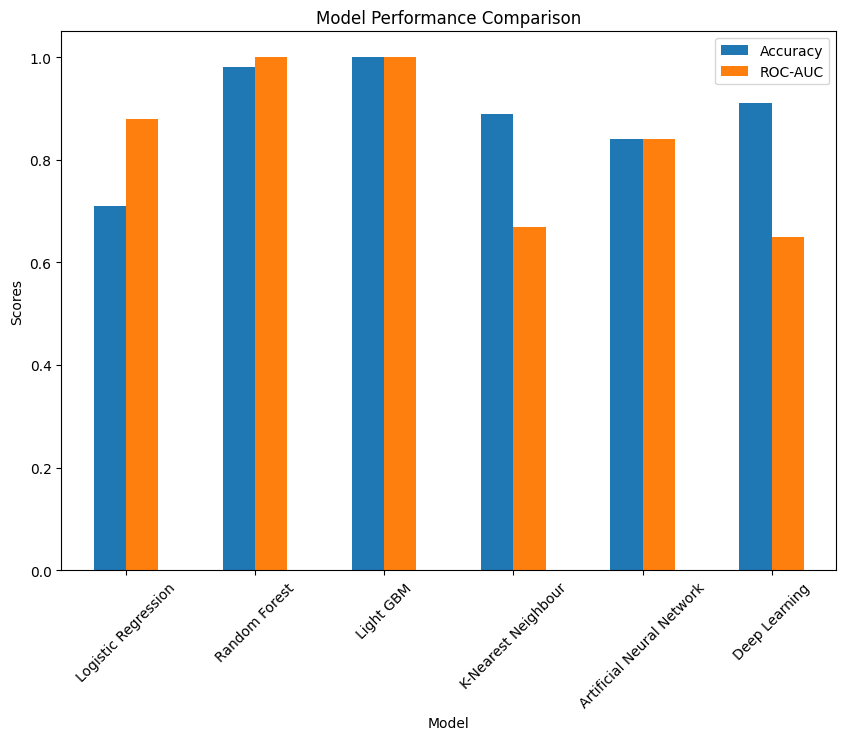

In [ ]:
performance_df.plot(x='Model', kind='bar', figsize=(10, 7), title='Model Performance Comparison')
plt.ylabel('Scores')
plt.xticks(rotation=45)
plt.show()

# **Key Findings:**

* The dataset was highly imbalanced since only 0.172% of the transactions were actually fraudulent. To address an imbalanced dataset created using SMOTE which helped generate more fraud accordingly.

* For the features like transaction amount (amt), outliers were capped at 1 st and 99th percentiles to prevent extreme values impacting model training.

**Visualization Insights:**


* This skew to lower amounts of fraudulent transaction was also observed when these data were mimicked with KDE plots, so this model is misclassifying higher amount transactions as being non-fraudulent.

* Heatmaps showed that the number of fraudulent transactions are more clustered and originated from some states than the rest, with California or New York showing higher rates. This insinuates that fraudsters may be regionally targeting.

* Strong correlations between features (eg, lat and merch_lat [correlation coefficient ~0.98]) were identified using a correlation matrix; therefore, to mitigate multicollinearity issues redundant features had been excluded from analysis.

* Data was also collected regarding transaction times and fraud, showing that late-night to early morning peaked from 12 AM – 6 AM in fraudulent activities.

* The bar charts confirmed the extreme skewness of data since fraudulent transactions constitute only an extremely small part in comparison to genuine one; hence, there arises a need for balancing methodologies such as SMOTE.

* Boxplot for features like amt shows that non-fraudulent transactions had a larger range of amts and fraudulent transactions were narrowly packed esp at lower ranges.

* When plotted against features like amt and city_pop, Pair plots showed us that fraudulent transactions neatly belong to their own clusters on these grounds, revealing how multiple features are interacting in order for the fraud signal.

**Model Performance:**

* LightGBM: With an accuracy and ROC-AUC of 1.00, where all fraud & non-fraud transactions were classified correctly in other words we can say this model is the best fit for this dataset which predicted it with highest score as well.

* Random Forest: Gave good results with accuracy of about 98%.This was particularly proficient in giving high recall for fraud detection i.e.so it detected most likely cases.

* Logistic Regressionrecall: 0.85, however precision was lower at only 0.28 which meant that there were many false positives This implies that if it caught 87% of fraudulent transactions, then in only correctly identified half the legitimate ones.

In [ ]:
# Print PrettyTable
print(pretty_table)

+---------------------------+----------+---------+
|           Model           | Accuracy | ROC-AUC |
+---------------------------+----------+---------+
|    Logistic Regression    |   0.71   |   0.88  |
|       Random Forest       |   0.98   |   1.0   |
|         Light GBM         |   1.0    |   1.0   |
|    K-Nearest Neighbour    |   0.89   |   0.67  |
| Artificial Neural Network |   0.84   |   0.84  |
|       Deep Learning       |   0.91   |   0.65  |
+---------------------------+----------+---------+
